# Emotion Detection using CNNs
Maastricht University, Computer Vision 2022

Assignment 2

----
Jannik Wirtz,
Lukas Santing

# 0 -  Imports

In [39]:
# Utils
import time
import cv2
import pandas as pd
import numpy as np
import warnings
import matplotlib.pyplot as plt
warnings.filterwarnings("ignore")
import keras
from keras.preprocessing.image import ImageDataGenerator 
from keras.metrics import Precision, Recall
from google.colab.patches import cv2_imshow # For Google Colab, instead of cv2.imshow

# Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from sklearn.model_selection import KFold

import tensorflow as tf
from tensorflow.keras.models import Model, Sequential, load_model
from tensorflow.keras.layers import Dense, Activation, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, BatchNormalization, Dropout, Lambda, concatenate
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint
from tensorflow.keras.regularizers import L2
from tensorflow.keras.models import model_from_json

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# 1 - Data Pre-processing


## 1.1 Loading data & splitting along predefined split

For this code you will need to have the open source Fer13 emotion dataset, available from Kaggle

**Edit this block to specify the path to the data in your folders**

In [3]:
# download fer2013.csv dataset from kaggle: https://www.kaggle.com/datasets/ashishpatel26/facial-expression-recognitionferchallenge/data
path = "/content/drive/MyDrive/"

The data is already split into an 80/10/10 split of Train, Validation and Test samples

In [4]:
def extractImages(datapoints):
  # Reshape sequences to images  
  width, height = 48, 48

  #getting features for training
  X = []
  for sequence in datapoints:
    pixels = [int(p) for p in sequence.split(' ')]
    pixels = np.asarray(pixels).reshape(width, height)
    X.append(pixels.astype('float32'))

  X = np.asarray(X)
  X = np.expand_dims(X, -1)
  return X

def load_FER13():
  # load the data from Google Drive into a Pandas DataFrame
  data = pd.read_csv(path + 'fer2013.csv')

  # Isolate the features (X) and the corresponding emotion labels (Y)
  X = data.loc[:, 'pixels']
  Y = data.loc[:, 'emotion']

  # Get NumPy arrays for each of the predefined splits of X and Y
  x_train = X.loc[data['Usage'] == 'Training'].values
  x_val =  X.loc[data['Usage'] == 'PrivateTest'].values
  x_test =  X.loc[data['Usage'] == 'PublicTest'].values

  y_train = Y.loc[data['Usage'] == 'Training'].values
  y_val =  Y.loc[data['Usage'] == 'PrivateTest'].values
  y_test =  Y.loc[data['Usage'] == 'PublicTest'].values
  
  #getting labels for training
  y_train = pd.get_dummies(y_train).values
  y_val = pd.get_dummies(y_val).values
  y_test = pd.get_dummies(y_test).values

  # Reshape to image
  x_train = extractImages(x_train)
  x_val = extractImages(x_val)
  x_test = extractImages(x_test)

  # Standardization
  train_mean = np.mean(x_train, axis=0)
  train_std = np.std(x_train, axis=0)

  x_train = (x_train - train_mean) / train_std
  x_val = (x_val - train_mean) / train_std
  x_test = (x_test - train_mean) / train_std


  return (x_train, y_train), (x_val, y_val), (x_test, y_test)

In [5]:
# Test block
(x_train, y_train), (x_val, y_val), (x_test, y_test) = load_FER13()

print(f"Shape of x_train, y_train = {x_train.shape}, {y_train.shape}")
print(f"Shape of x_val, y_val = {x_val.shape}, {y_val.shape}")
print(f"Shape of x_test, y_test = {x_test.shape}, {y_test.shape}")
print("----------------------------------")
print(f"Example pairing, at train position 100 = Y={y_train[100]}, X=[{x_train[100]}]")

Shape of x_train, y_train = (28709, 48, 48, 1), (28709, 7)
Shape of x_val, y_val = (3589, 48, 48, 1), (3589, 7)
Shape of x_test, y_test = (3589, 48, 48, 1), (3589, 7)
----------------------------------
Example pairing, at train position 100 = Y=[0 0 0 1 0 0 0], X=[[[[ 0.5057568 ]
  [ 0.54036105]
  [ 0.56134754]
  ...
  [ 0.22347   ]
  [ 0.07230412]
  [-0.17127348]]

 [[ 0.3527106 ]
  [ 0.4854783 ]
  [ 0.59253603]
  ...
  [ 0.23868991]
  [ 0.09743391]
  [ 0.02355475]]

 [[ 0.29847273]
  [ 0.41660807]
  [ 0.5357278 ]
  ...
  [ 0.17773536]
  [ 0.12459023]
  [ 0.03673117]]

 ...

 [[ 0.74928844]
  [ 0.48755175]
  [ 0.2356041 ]
  ...
  [ 1.0517315 ]
  [ 1.0302312 ]
  [ 0.9973931 ]]

 [[ 0.8510054 ]
  [ 0.79193306]
  [ 0.3512097 ]
  ...
  [ 1.1407919 ]
  [ 1.132826  ]
  [ 1.099199  ]]

 [[ 1.1282753 ]
  [ 0.8951973 ]
  [ 0.4950125 ]
  ...
  [ 1.0258174 ]
  [ 1.0196126 ]
  [ 1.0393636 ]]]]


# 2 - Build Model Functions

In [6]:
# Just in case we need it
def PermaDropout(rate): # insures usage of dropout in evaluation (tf disables normal dropout in testing by default)
    return Lambda(lambda x: tf.keras.backend.dropout(x, level=rate))

def buildModel(activation_function='relu', padding='same', kernel_sizes=[(3,3)], filters=(8, 12), 
                pooling_kernels = [(2,2)], dilation_rate = (1,1), strides = (1,1), 
                input_shape=(48, 48, 1), dense_units=[], output_classes=7, dropout_rate=0):
    """
        function that builds a CNN model with an architecture specified in its parameters.
    
    """
    assert len(kernel_sizes) == len(filters), "Please make sure you define a kernel size for every ConvLayer"
    #input_shape: 48 x 48 pixels with 1 color channel?

    model = Sequential() # using a sequential architecture
    # Feature Extractor (CNN part)
    for i in range(len(filters)):    
        if i == 0:
            # input layer
            model.add(Conv2D(
                activation=activation_function,
                filters=filters[i],
                kernel_size=kernel_sizes[i],
                padding=padding,
                strides=strides,
                data_format='channels_last',
                dilation_rate=dilation_rate, # dilation only used in first layer for now
                input_shape=input_shape))
        else:
          # Hidden Layers
          model.add(Conv2D(
              activation=activation_function,
              filters=filters[i],
              kernel_size=kernel_sizes[i],
              padding=padding,
              strides=strides
              )
          )
          
          model.add(BatchNormalization())

        if i < len(pooling_kernels):
            model.add(MaxPooling2D(pooling_kernels[i]))
    
        if dropout_rate is not None and dropout_rate != 0:
            model.add(PermaDropout(dropout_rate))

    # ANN part (Classifier)
    model.add(Flatten())
    for units in dense_units:
        model.add(Dense(units, activation=activation_function))

        if dropout_rate is not None and dropout_rate != 0:
            model.add(PermaDropout(dropout_rate))
    # ouput prediction of 7 class probabilities
    model.add(Dense(output_classes, activation='softmax'))
    return model

In [7]:
def compileModel(model, initial_lr, lr_decay):

    # Learning rate handling
    if lr_decay == 1:
        lr_schedule = initial_lr    
    else:
        lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(initial_lr, decay_steps=16, decay_rate=lr_decay, staircase=True)
    opt = Adam(learning_rate=lr_schedule)
    model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

    return model

In [8]:
def runtest(model, epochs, batchsize, model_name=''):
    # unpack data
    # just using global variables...
    # (x_train, y_train), (x_val, y_val), (x_test, y_test) = load_FER13()

    start_time = time.time()
    callbacks_list = []#[ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, verbose=1)]

    callbacks_list.append(
    tf.keras.callbacks.ModelCheckpoint(
            'checkpoint.h5',
            monitor='val_loss',
            save_best_only=True,
            save_weights_only=False,
            save_freq='epoch', verbose=0
        )
    )
        
    print("train_data.shape=", len(x_train), len(y_train))
    print("batchsize=", batchsize)
    print("epochs=", epochs)

    # history = model.fit(x=x_train, y=y_train,
    #                     batch_size=batchsize,
    #                     epochs=epochs, # Iterations are epochs <- better for plotting... smaller steps
    #                     validation_data=(x_val, y_val),
    #                     callbacks=callbacks_list,
    #                     shuffle=True)
    
    history = model.fit(x=x_train, y=y_train,
                        batch_size=batchsize,
                        epochs=epochs, # Iterations are epochs <- better for plotting... smaller steps
                        validation_data=(x_val, y_val),
                        callbacks=callbacks_list,
                        shuffle=True)

    print("Evaluate on test data")
    model.evaluate(x=x_test, y=y_test, batch_size=batchsize)

    print("--- %s seconds ---" % (time.time() - start_time))

    np.save(model_name +'_history.npy',history.history)
    model.save(model_name + '.h5') # around 395 mb...

    return history

In [9]:
def training_validation_graphs(history, model_name, color='b', fields=['loss', 'val_loss'], skip=0):
    fontsize = 14
    plt.rc('axes', titlesize=fontsize)     # fontsize of the axes title
    plt.rc('axes', labelsize=fontsize)     # fontsize of the axes title
    plt.rc('xtick', labelsize=fontsize)    # fontsize of the tick labels
    plt.rc('ytick', labelsize=fontsize)    # fontsize of the tick labels
    plt.rc('legend', fontsize=fontsize)    # legend fontsize
    loss = history.history[fields[0]][skip:]
    val_loss = history.history[fields[1]][skip:]
    epochs = range(skip + 1, len(loss) + skip + 1)

    plt.plot(epochs, loss, color=color, linestyle='dotted', label=model_name + ' In-Sample ' + fields[0])
    plt.plot(epochs, val_loss, color=color, label=model_name + ' Out-of-Sample ' + fields[0])
    #plt.title('')
    plt.xlabel('Epoch')
    plt.ylabel(fields[0])
    # plt.legend()
    # plt.savefig(model_name + ' min_' + fields[1] + '=' + str(np.min(history.history[fields[1]])) + '.png')
    # plt.show()

In [10]:
def imageAugmentAndGenerate(x_train, y_train, x_val, y_val, x_test, y_test, 
                            rotation_range=10, 
                            horizontal_flip=True, 
                            width_shift_range=0.1,
                            height_shift_range=0.1, 
                            batch_size=64):
  
  datagen = ImageDataGenerator(rotation_range=rotation_range,
                               horizontal_flip=horizontal_flip,
                               width_shift_range=width_shift_range,
                               height_shift_range=height_shift_range,
                               fill_mode='nearest')
  testgen = ImageDataGenerator()
  
  datagen.fit(x_train)

  # data will be generated in the batches of specified size
  train_flow = datagen.flow(x_train, y_train, batch_size=batch_size)
  val_flow = testgen.flow(x_val, y_val, batch_size=batch_size)
  test_flow = testgen.flow(x_test, y_test, batch_size=batch_size)

  return train_flow, val_flow, test_flow

In [11]:
# TEMP FUNCTION FOR K-FOLD: Need to implement it into above function, but don't want to mess up and fix all of the current experiment code yet

def imageAugmentAndGenerateNoVal(x_train, y_train, x_test, y_test, 
                            rotation_range=10, 
                            horizontal_flip=True, 
                            width_shift_range=0.1,
                            height_shift_range=0.1, 
                            batch_size=64):
  
  datagen = ImageDataGenerator(rotation_range=rotation_range,
                               horizontal_flip=horizontal_flip,
                               width_shift_range=width_shift_range,
                               height_shift_range=height_shift_range,
                               fill_mode='nearest')
  testgen = ImageDataGenerator()
  
  datagen.fit(x_train)

  # data will be generated in the batches of specified size
  train_flow = datagen.flow(x_train, y_train, batch_size=batch_size)
  test_flow = testgen.flow(x_test, y_test, batch_size=batch_size)

  return train_flow, test_flow

In [ ]:
# TEST CODE

train_flow, val_flow, test_flow = imageAugmentAndGenerate(x_train, y_train, x_val, y_val, x_test, y_test, batch_size=64)

# 3 - Model Hyperparameter Optimization

Experiments with the varous model hyperparameters to find the optimal model setup.

## 3.1 Number of Layers and Units

Experiment with layer sizes of (128, 2), (64, 2), (64, 4), (32, 4), (16, 6)

In [ ]:
### HYPERPARAMETERS
learning_rate = 1e-4
lr_decay = 1
L2_reg_rate = 0
batchsize = 64
epochs = 20

# (#-units inital, #-layers)
test_set = [(128, 2), (64, 2), (64, 4), (32, 4), (16, 6)] # adds 2 dense layers at end.. so 8 max for conv layers
histories = []

for initial, layers in test_set:
  kernelsizes = [(3,3) for i in range(layers)]
  pooling = [(2,2) for i in range(3)]
            
  filterunits = [initial*pow(2,i) for i in range(len(kernelsizes))]
  dense = [filterunits[-1], filterunits[-2]] # same as last conv filtercount

  model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

  model = buildModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                  filters=filterunits, pooling_kernels = pooling, dilation_rate = (1,1),
                  strides = (1,1), input_shape=(48, 48, 1), dense_units=dense, output_classes=7,
                  dropout_rate=0.25)

  model = compileModel(model, learning_rate, lr_decay)
  model.summary()
  # Train
  histories.append(runtest(model, epochs, batchsize, model_name))

Plot the loss

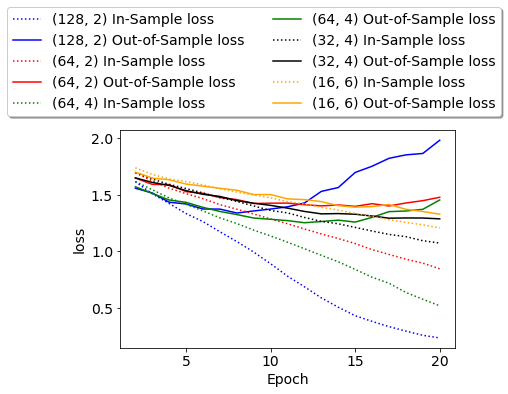

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], skip = 1)
    
    # training_validation_graphs(history, model_name)
    # training_validation_graphs(history, model_name, fields=['accuracy', 'val_accuracy'])


plt.legend(loc='upper center', bbox_to_anchor=(0.4, 1.6), ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

Plot the accuracy

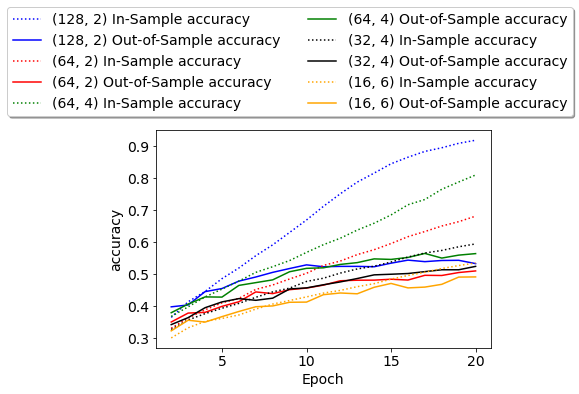

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], fields=['accuracy', 'val_accuracy'], skip = 1)


plt.legend(loc='upper center', bbox_to_anchor=(0.4, 1.6), ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

## 3.2 Kernel Size

Experiment with kernel sizes of (3,3), (5,5), (7,7)

In [ ]:
### HYPERPARAMETERS
learning_rate = 1e-4
lr_decay = 1
L2_reg_rate = 0
batchsize = 64
epochs = 20
initial = 64
layers = 4

# (#-units inital, #-layers)
test_set = [(3,3), (5,5), (7,7)]
histories = []


for kernel_size in test_set:
  kernelsizes = [kernel_size for i in range(layers)]
  pooling = [(2,2) for i in range(3)]
            
  filterunits = [initial*pow(2,i) for i in range(len(kernelsizes))]
  dense = [filterunits[-1], filterunits[-2]] # same as last conv filtercount

  model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

  model = buildModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                  filters=filterunits, pooling_kernels = pooling, dilation_rate = (1,1),
                  strides = (1,1), input_shape=(48, 48, 1), dense_units=dense, output_classes=7,
                  dropout_rate=0.25)

  model = compileModel(model, learning_rate, lr_decay)
  model.summary()
  # Train
  histories.append(runtest(model, epochs, batchsize, model_name))

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_26 (Conv2D)          (None, 48, 48, 64)        640       
                                                                 
 max_pooling2d_18 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 lambda_40 (Lambda)          (None, 24, 24, 64)        0         
                                                                 
 conv2d_27 (Conv2D)          (None, 24, 24, 128)       73856     
                                                                 
 batch_normalization_19 (Bat  (None, 24, 24, 128)      512       
 chNormalization)                                                
                                                                 
 max_pooling2d_19 (MaxPoolin  (None, 12, 12, 128)     

Plot the loss

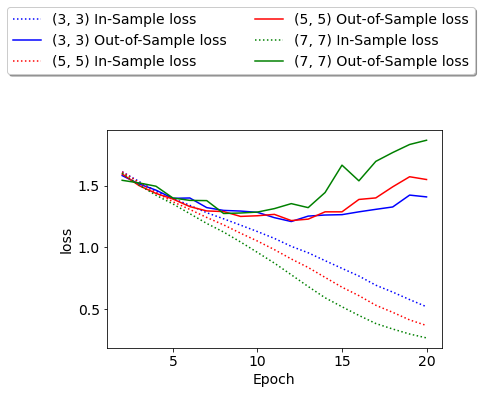

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], skip = 1)
    
    # training_validation_graphs(history, model_name)
    # training_validation_graphs(history, model_name, fields=['accuracy', 'val_accuracy'])


plt.legend(loc='upper center', bbox_to_anchor=(0.4, 1.6), ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

Plot the accuracy

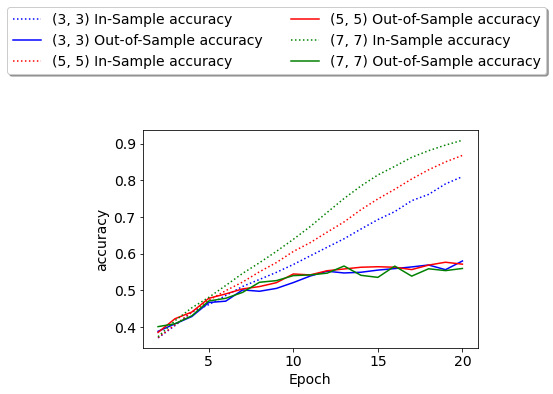

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], fields=['accuracy', 'val_accuracy'], skip = 1)


plt.legend(loc='upper center', bbox_to_anchor=(0.4, 1.6), ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

## 3.3 Dropout Rate

Experiment with dropout rates of 0, 0.1, 0.2, 0.3, 0.4, 0.5

In [ ]:
### HYPERPARAMETERS
learning_rate = 1e-4
lr_decay = 1
L2_reg_rate = 0
batchsize = 64
epochs = 20
initial = 64
layers = 4

# (#-units inital, #-layers)
test_set = [0, 0.1, 0.2, 0.3, 0.4, 0.5] 
histories = []


for dropout in test_set:
  kernelsizes = [(3,3) for i in range(layers)]
  pooling = [(2,2) for i in range(3)]
            
  filterunits = [initial*pow(2,i) for i in range(len(kernelsizes))]
  dense = [filterunits[-1], filterunits[-2]] # same as last conv filtercount

  model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

  model = buildModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                  filters=filterunits, pooling_kernels = pooling, dilation_rate = (1,1),
                  strides = (1,1), input_shape=(48, 48, 1), dense_units=dense, output_classes=7,
                  dropout_rate=dropout)

  model = compileModel(model, learning_rate, lr_decay)
  model.summary()
  # Train
  histories.append(runtest(model, epochs, batchsize, model_name))

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_46 (Conv2D)          (None, 48, 48, 64)        640       
                                                                 
 max_pooling2d_33 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_47 (Conv2D)          (None, 24, 24, 128)       73856     
                                                                 
 batch_normalization_34 (Bat  (None, 24, 24, 128)      512       
 chNormalization)                                                
                                                                 
 max_pooling2d_34 (MaxPoolin  (None, 12, 12, 128)      0         
 g2D)                                                            
                                                     

Plot the loss

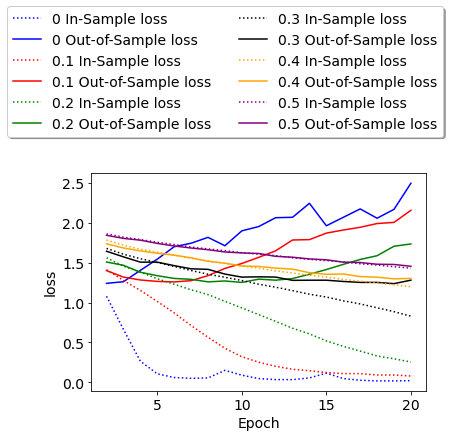

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], skip = 1)


plt.legend(loc='upper center', bbox_to_anchor=(0.4, 1.8), ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

Plot the accuracy

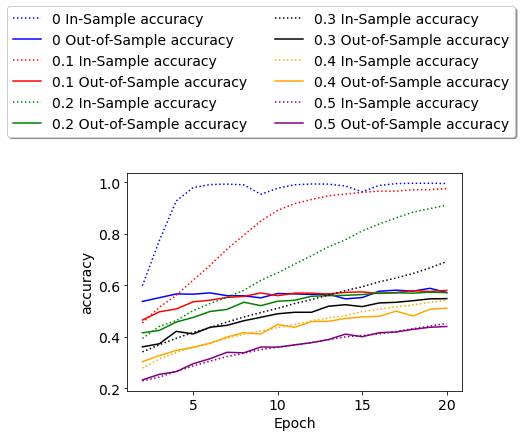

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], fields=['accuracy', 'val_accuracy'], skip = 1)


plt.legend(loc='upper center', bbox_to_anchor=(0.4, 1.8), ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

## 3.4 Dilation Rate

Experiment with dilation rate of (1,1), (2,2), (3,3)

In [ ]:
### HYPERPARAMETERS
learning_rate = 1e-4
lr_decay = 1
L2_reg_rate = 0
batchsize = 64
epochs = 40
initial = 64
layers = 4

test_set = [(1,1), (2,2), (3,3)] 
histories = []


for dilationrate in test_set:
  kernelsizes = [(3,3) for i in range(layers)]
  pooling = [(2,2) for i in range(3)]
            
  filterunits = [initial*pow(2,i) for i in range(len(kernelsizes))]
  dense = [filterunits[-1], filterunits[-2]] # same as last conv filtercount

  model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

  model = buildModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                  filters=filterunits, pooling_kernels = pooling, dilation_rate = dilationrate,
                  strides = (1,1), input_shape=(48, 48, 1), dense_units=dense, output_classes=7,
                  dropout_rate=0.25)

  model = compileModel(model, learning_rate, lr_decay)
  model.summary()
  # Train
  histories.append(runtest(model, epochs, batchsize, model_name))

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_90 (Conv2D)          (None, 48, 48, 64)        640       
                                                                 
 max_pooling2d_66 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 lambda_124 (Lambda)         (None, 24, 24, 64)        0         
                                                                 
 conv2d_91 (Conv2D)          (None, 24, 24, 128)       73856     
                                                                 
 batch_normalization_67 (Bat  (None, 24, 24, 128)      512       
 chNormalization)                                                
                                                                 
 max_pooling2d_67 (MaxPoolin  (None, 12, 12, 128)    

Plot the loss

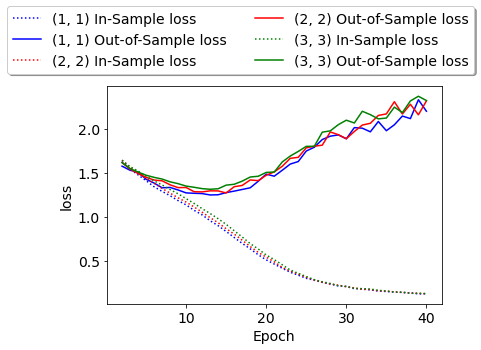

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], skip = 1)


plt.legend(loc='upper center', bbox_to_anchor=(0.4, 1.4), ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

Plot the accuracy

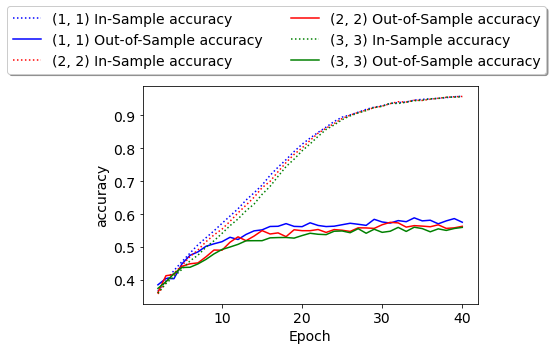

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], fields=['accuracy', 'val_accuracy'], skip = 1)


plt.legend(loc='upper center', bbox_to_anchor=(0.4, 1.4), ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

# 4 - Data Augmentation Hyperparameter Optimization

Using the best model parameters as determined in section 3, use experiment with parameters of data augmentation to find final best model.

## 4.1 Rotation range

Experimenting with data augmentation rotation ranges of 10, 20, 30, 40, 50, 60

In [ ]:
# Testing best with data augmentation
# Uses the train and val flows from Keras data augmentation instead of raw data
batch_size = 64
height_shift_range=0.1
width_shift_range=0.1
horizontal_flip=True
# rotation_range=10

test_set = [10, 20, 40, 60, 80]
histories = []

for rotation_range in test_set:

  train_flow, val_flow, test_flow = imageAugmentAndGenerate(x_train, y_train, x_val, y_val, x_test, y_test, 
                              rotation_range=rotation_range, 
                              horizontal_flip=horizontal_flip, 
                              width_shift_range=width_shift_range,
                              height_shift_range=height_shift_range, 
                              batch_size=batch_size)

  ### HYPERPARAMETERS
  learning_rate = 1e-4
  lr_decay = 1
  L2_reg_rate = 0
  batchsize = 64
  epochs = 50             # was 40
  initial = 64
  layers = 4

  kernelsizes = [(3,3) for i in range(layers)]
  pooling = [(2,2) for i in range(3)]
          
  filterunits = [initial*pow(2,i) for i in range(len(kernelsizes))]
  dense = [filterunits[-1], filterunits[-2]] # same as last conv filtercount

  model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

  model = buildModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                  filters=filterunits, pooling_kernels = pooling, dilation_rate = (1,1),
                  strides = (1,1), input_shape=(48, 48, 1), dense_units=dense, output_classes=7,
                  dropout_rate=0.25)

  opt = Adam(lr=0.001, decay=1e-6)
  model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
  model.summary()

  history = model.fit_generator(train_flow, 
                    steps_per_epoch=len(x_train) / batch_size, 
                    epochs=epochs,  
                    verbose=1,  
                    validation_data=val_flow)

  histories.append(history)

  np.save(model_name +'_history.npy',history.history)
  model.save(model_name + '.h5') # around 395 mb...

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 48, 48, 64)        640       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 24, 24, 64)       0         
 )                                                               
                                                                 
 lambda (Lambda)             (None, 24, 24, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 24, 24, 128)       73856     
                                                                 
 batch_normalization (BatchN  (None, 24, 24, 128)      512       
 ormalization)                                                   
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 12, 12, 128)      0

Plot the loss

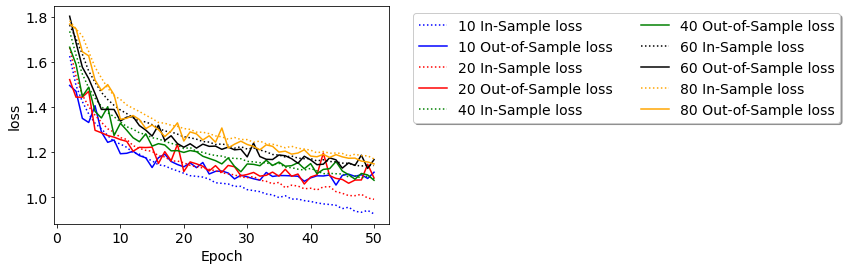

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

Plot the accuracy

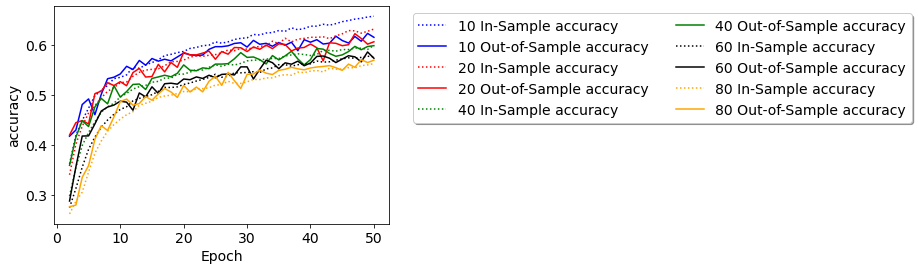

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], fields=['accuracy', 'val_accuracy'], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

## 4.2 Shift range

Experimenting with data augmentation shift ranges of 0.1, 0.2, 0.4, 0.6, 0.8

In [ ]:
# Testing best with data augmentation
# Uses the train and val flows from Keras data augmentation instead of raw data
batch_size = 64
# height_shift_range=0.1
# width_shift_range=0.1
horizontal_flip=True
rotation_range=10

test_set = [0.1, 0.2, 0.4, 0.6, 0.8]
histories = []

for shift_range in test_set:

  train_flow, val_flow, test_flow = imageAugmentAndGenerate(x_train, y_train, x_val, y_val, x_test, y_test, 
                              rotation_range=rotation_range, 
                              horizontal_flip=horizontal_flip, 
                              width_shift_range=shift_range,
                              height_shift_range=shift_range, 
                              batch_size=batch_size)

  ### HYPERPARAMETERS
  learning_rate = 1e-4
  lr_decay = 1
  L2_reg_rate = 0
  batchsize = 64
  epochs = 50             # was 40
  initial = 64
  layers = 4

  kernelsizes = [(3,3) for i in range(layers)]
  pooling = [(2,2) for i in range(3)]
          
  filterunits = [initial*pow(2,i) for i in range(len(kernelsizes))]
  dense = [filterunits[-1], filterunits[-2]] # same as last conv filtercount

  model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

  model = buildModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                  filters=filterunits, pooling_kernels = pooling, dilation_rate = (1,1),
                  strides = (1,1), input_shape=(48, 48, 1), dense_units=dense, output_classes=7,
                  dropout_rate=0.25)

  opt = Adam(lr=0.001, decay=1e-6)
  model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
  model.summary()

  history = model.fit_generator(train_flow, 
                    steps_per_epoch=len(x_train) / batch_size, 
                    epochs=epochs,  
                    verbose=1,  
                    validation_data=val_flow)

  histories.append(history)

  np.save(model_name +'_history.npy',history.history)
  model.save(model_name + '.h5') # around 395 mb...

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_20 (Conv2D)          (None, 48, 48, 64)        640       
                                                                 
 max_pooling2d_15 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 lambda_30 (Lambda)          (None, 24, 24, 64)        0         
                                                                 
 conv2d_21 (Conv2D)          (None, 24, 24, 128)       73856     
                                                                 
 batch_normalization_15 (Bat  (None, 24, 24, 128)      512       
 chNormalization)                                                
                                                                 
 max_pooling2d_16 (MaxPoolin  (None, 12, 12, 128)     

Plot the loss

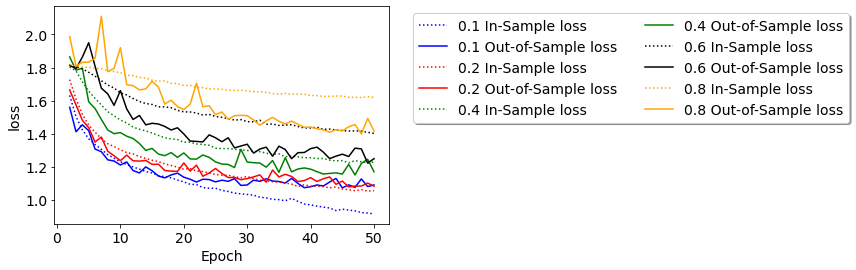

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

Plot the accuracy

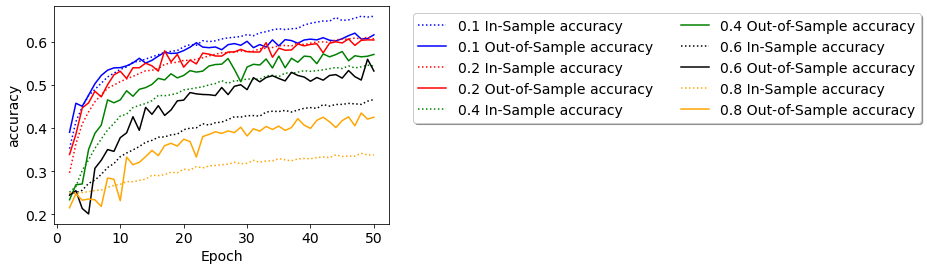

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], fields=['accuracy', 'val_accuracy'], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

## 4.3 Horizontal flip

Experimenting with data augmentation boolean horizontal_flip value

In [ ]:
# Testing best with data augmentation
# Uses the train and val flows from Keras data augmentation instead of raw data
batch_size = 64
height_shift_range=0.1
width_shift_range=0.1
# horizontal_flip=True
rotation_range=10

test_set = [True, False]
histories = []

for horizontal_flip in test_set:

  train_flow, val_flow, test_flow = imageAugmentAndGenerate(x_train, y_train, x_val, y_val, x_test, y_test, 
                              rotation_range=rotation_range, 
                              horizontal_flip=horizontal_flip, 
                              width_shift_range=height_shift_range,
                              height_shift_range=width_shift_range, 
                              batch_size=batch_size)

  ### HYPERPARAMETERS
  learning_rate = 1e-4
  lr_decay = 1
  L2_reg_rate = 0
  batchsize = 64
  epochs = 50             # was 40
  initial = 64
  layers = 4

  kernelsizes = [(3,3) for i in range(layers)]
  pooling = [(2,2) for i in range(3)]
          
  filterunits = [initial*pow(2,i) for i in range(len(kernelsizes))]
  dense = [filterunits[-1], filterunits[-2]] # same as last conv filtercount

  model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

  model = buildModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                  filters=filterunits, pooling_kernels = pooling, dilation_rate = (1,1),
                  strides = (1,1), input_shape=(48, 48, 1), dense_units=dense, output_classes=7,
                  dropout_rate=0.25)

  opt = Adam(lr=0.001, decay=1e-6)
  model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
  model.summary()

  history = model.fit_generator(train_flow, 
                    steps_per_epoch=len(x_train) / batch_size, 
                    epochs=epochs,  
                    verbose=1,  
                    validation_data=val_flow)

  histories.append(history)

  np.save(model_name +'_history.npy',history.history)
  model.save(model_name + '.h5') # around 395 mb...

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_40 (Conv2D)          (None, 48, 48, 64)        640       
                                                                 
 max_pooling2d_30 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 lambda_60 (Lambda)          (None, 24, 24, 64)        0         
                                                                 
 conv2d_41 (Conv2D)          (None, 24, 24, 128)       73856     
                                                                 
 batch_normalization_30 (Bat  (None, 24, 24, 128)      512       
 chNormalization)                                                
                                                                 
 max_pooling2d_31 (MaxPoolin  (None, 12, 12, 128)    

Plot the loss

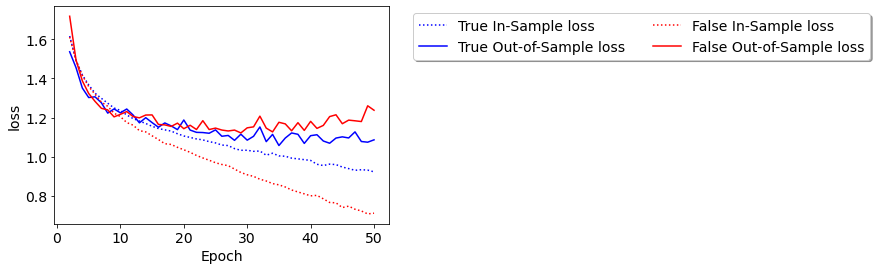

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

Plot the accuracy

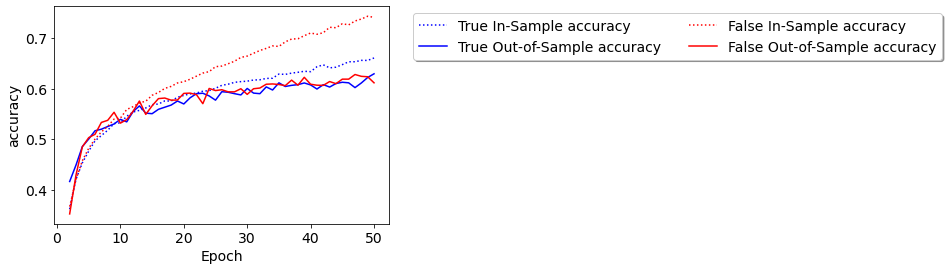

In [ ]:
# For plotting
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(test_set)]
for i in range(len(test_set)):
    training_validation_graphs(histories[i], model_name=str(test_set[i]), color=colors[i%len(colors)], fields=['accuracy', 'val_accuracy'], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

# 5 - Final model test

## 5.1 Best model with (100) epochs on validation & test data

In [113]:
# Uses the train and val flows from Keras data augmentation instead of raw data
batch_size = 64
height_shift_range=0.1
width_shift_range=0.1
horizontal_flip=True
rotation_range=10
train_flow, val_flow, test_flow = imageAugmentAndGenerate(x_train, y_train, x_val, y_val, x_test, y_test, 
                              rotation_range=rotation_range, 
                              horizontal_flip=horizontal_flip, 
                              width_shift_range=height_shift_range,
                              height_shift_range=width_shift_range, 
                              batch_size=batch_size)

### 5.1.1 Validation set

In [114]:
histories_vtest = []

test_set = [val_flow]

for test_val_flow in test_set:
  

  ### HYPERPARAMETERS
  learning_rate = 1e-6
  lr_decay = 1
  L2_reg_rate = 0
  batchsize = 64
  epochs = 100
  initial = 64
  layers = 4

  kernelsizes = [(3,3) for i in range(layers)]
  pooling = [(2,2) for i in range(3)]
          
  filterunits = [initial*pow(2,i) for i in range(len(kernelsizes))]
  dense = [filterunits[-1], filterunits[-2]] # same as last conv filtercount

  model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

  model = buildModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                  filters=filterunits, pooling_kernels = pooling, dilation_rate = (1,1),
                  strides = (1,1), input_shape=(48, 48, 1), dense_units=dense, output_classes=7,
                  dropout_rate=0.25)

  opt = Adam(lr=0.001, decay=1e-6)
  model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy', Precision(), Recall()])
  model.summary()
  

  start_time = time.time()
  callbacks_list = []#[ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, verbose=1)]

  callbacks_list.append(
  tf.keras.callbacks.ModelCheckpoint(
          'checkpoint.h5',
          monitor='val_loss',
          save_best_only=True,
          save_weights_only=False,
          save_freq='epoch', verbose=0
      )
  )

  history = model.fit_generator(train_flow, 
                    steps_per_epoch=len(x_train) / batch_size, 
                    epochs=epochs,  
                    verbose=1,  
                    validation_data=test_val_flow)

  histories_vtest.append(history)

  np.save(model_name +'_history.npy',history.history)
  model.save(model_name + '.h5') # around 395 mb...

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 48, 48, 64)        640       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 24, 24, 64)       0         
 )                                                               
                                                                 
 lambda (Lambda)             (None, 24, 24, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 24, 24, 128)       73856     
                                                                 
 batch_normalization (BatchN  (None, 24, 24, 128)      512       
 ormalization)                                                   
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 12, 12, 128)      0

In [115]:
labels=["Validation Data"]

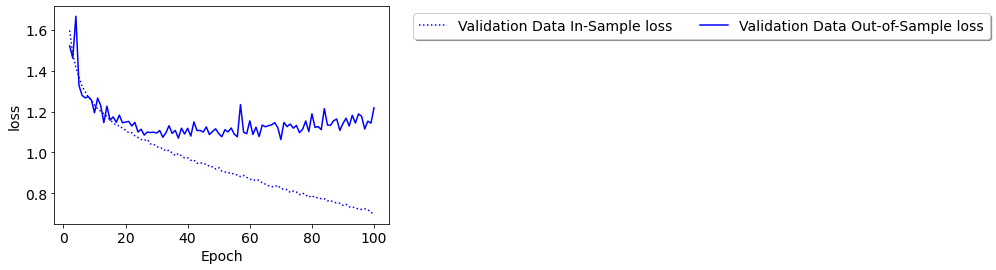

In [116]:
# For plotting: loss
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(labels)]
for i in range(len(labels)):
    training_validation_graphs(histories_vtest[i], model_name=str(labels[i]), color=colors[i%len(colors)], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

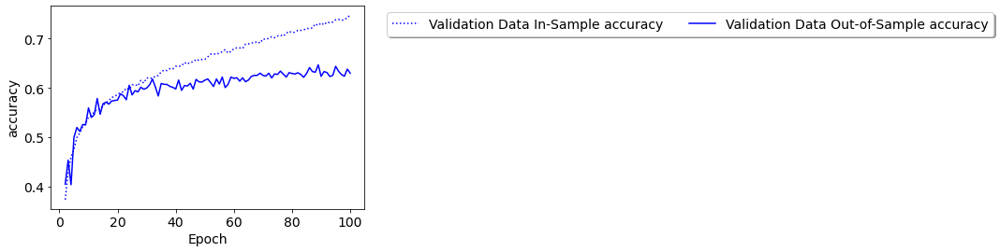

In [117]:
# For plotting: accuracy
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(labels)]
for i in range(len(labels)):
    training_validation_graphs(histories_vtest[i], model_name=str(labels[i]), color=colors[i%len(colors)], fields=['accuracy', 'val_accuracy'], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

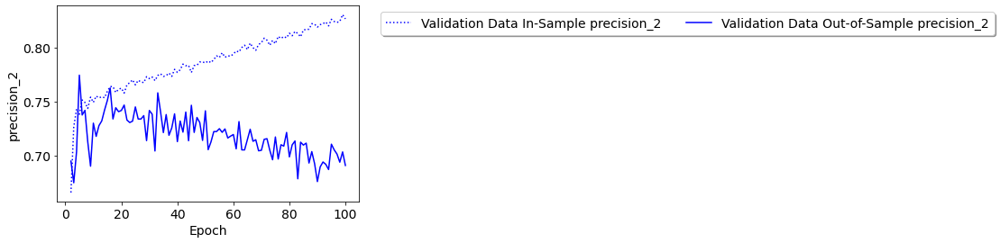

In [ ]:
# For plotting: precision
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(labels)]
for i in range(len(labels)):
    training_validation_graphs(histories[i], model_name=str(labels[i]), color=colors[i%len(colors)], fields=['precision_2', 'val_precision_2'], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

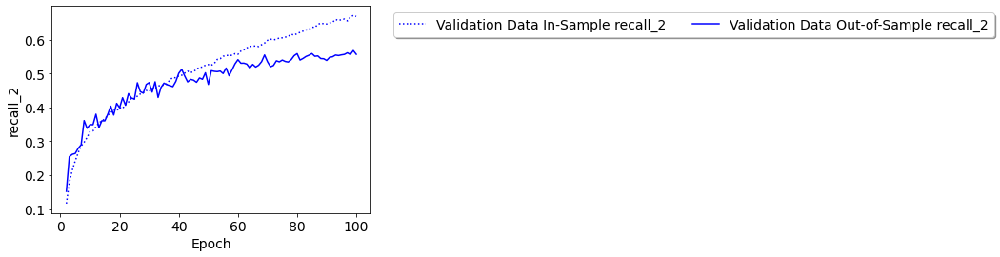

In [ ]:
# For plotting: recall
colors = ['b', 'r', 'green', 'black', 'orange', 'purple']
colors = colors[:len(labels)]
for i in range(len(labels)):
    training_validation_graphs(histories[i], model_name=str(labels[i]), color=colors[i%len(colors)], fields=['recall_2', 'val_recall_2'], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

### 5.1.2 Test set

In [ ]:
histories = []

test_set = [test_flow]

for test_val_flow in test_set:
  

  ### HYPERPARAMETERS
  learning_rate = 1e-4
  lr_decay = 1
  L2_reg_rate = 0
  batchsize = 64
  epochs = 100
  initial = 64
  layers = 4

  kernelsizes = [(3,3) for i in range(layers)]
  pooling = [(2,2) for i in range(3)]
          
  filterunits = [initial*pow(2,i) for i in range(len(kernelsizes))]
  dense = [filterunits[-1], filterunits[-2]] # same as last conv filtercount

  model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

  model = buildModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                  filters=filterunits, pooling_kernels = pooling, dilation_rate = (1,1),
                  strides = (1,1), input_shape=(48, 48, 1), dense_units=dense, output_classes=7,
                  dropout_rate=0.25)

  opt = Adam(lr=0.001, decay=1e-6)
  model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy', Precision(), Recall()])
  model.summary()

  history = model.fit_generator(train_flow, 
                    steps_per_epoch=len(x_train) / batch_size, 
                    epochs=epochs,  
                    verbose=1,  
                    validation_data=test_val_flow)

  histories.append(history)

  np.save(model_name +'_history.npy',history.history)
  model.save(model_name + '.h5') # around 395 mb...

Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_72 (Conv2D)          (None, 48, 48, 64)        640       
                                                                 
 max_pooling2d_54 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 lambda_108 (Lambda)         (None, 24, 24, 64)        0         
                                                                 
 conv2d_73 (Conv2D)          (None, 24, 24, 128)       73856     
                                                                 
 batch_normalization_54 (Bat  (None, 24, 24, 128)      512       
 chNormalization)                                                
                                                                 
 max_pooling2d_55 (MaxPoolin  (None, 12, 12, 128)    

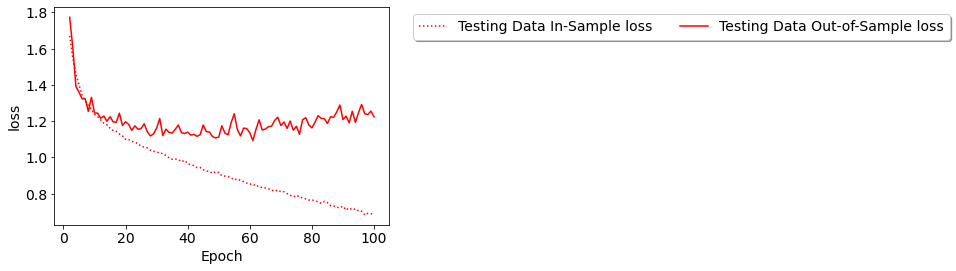

In [ ]:
labels=["Testing Data"]

# For plotting: loss
colors = ['r', 'b', 'green', 'black', 'orange', 'purple']
colors = colors[:len(labels)]
for i in range(len(labels)):
    training_validation_graphs(histories[i], model_name=str(labels[i]), color=colors[i%len(colors)], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

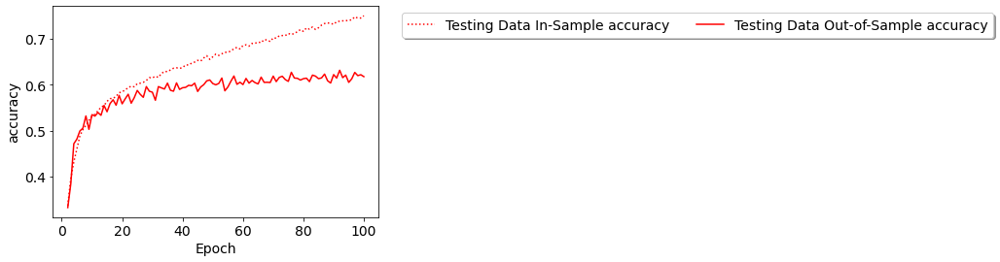

In [ ]:
labels=["Testing Data"]

# For plotting: accuracy
colors = ['r', 'b', 'green', 'black', 'orange', 'purple']
colors = colors[:len(labels)]
for i in range(len(labels)):
    training_validation_graphs(histories[i], model_name=str(labels[i]), color=colors[i%len(colors)], fields=['accuracy', 'val_accuracy'], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

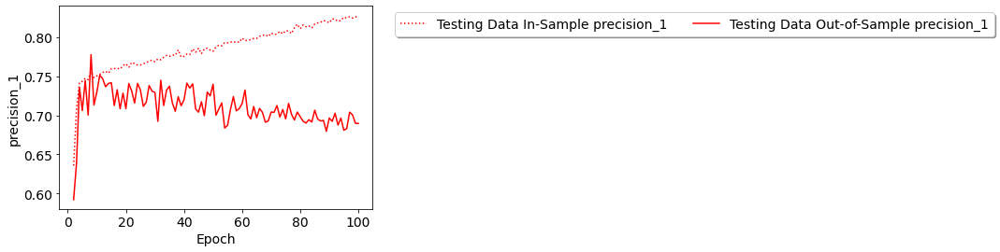

In [ ]:
labels=["Testing Data"]

# For plotting: precision
colors = ['r', 'b', 'green', 'black', 'orange', 'purple']
colors = colors[:len(labels)]
for i in range(len(labels)):
    training_validation_graphs(histories[i], model_name=str(labels[i]), color=colors[i%len(colors)], fields=['precision_1', 'val_precision_1'], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

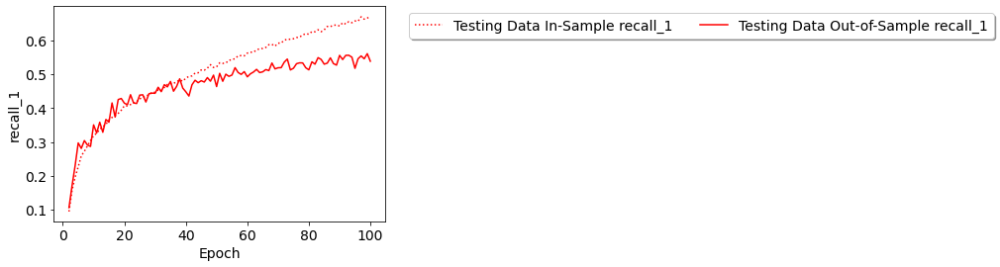

In [ ]:
labels=["Testing Data"]

# For plotting: recall
colors = ['r', 'b', 'green', 'black', 'orange', 'purple']
colors = colors[:len(labels)]
for i in range(len(labels)):
    training_validation_graphs(histories[i], model_name=str(labels[i]), color=colors[i%len(colors)], fields=['recall_1', 'val_recall_1'], skip = 1)


plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', ncol=2, fancybox=True, shadow=True)
#plt.ylim([0.0,1])
plt.show()

## 5.2 With k-fold cross validation

In [ ]:
# load the data from Google Drive into a Pandas DataFrame
data = pd.read_csv(path + 'fer2013.csv')

# Isolate the features (X) and the corresponding emotion labels (Y)
X = data.loc[:, 'pixels']
Y = data.loc[:, 'emotion']

# Do k-fold split
n_split = 5
k_histories = []

for train_index, test_index in KFold(n_split).split(X):
  x_train, x_test = X[train_index], X[test_index]
  y_train, y_test = Y[train_index], Y[test_index]
  
  #getting labels for training
  y_train = pd.get_dummies(y_train).values
  y_test = pd.get_dummies(y_test).values

  # Reshape to image
  x_train = extractImages(x_train)
  x_test = extractImages(x_test)

  # Standardization
  train_mean = np.mean(x_train, axis=0)
  train_std = np.std(x_train, axis=0)

  x_train = (x_train - train_mean) / train_std
  x_test = (x_test - train_mean) / train_std

  # Uses the train and val flows from Keras data augmentation instead of raw data
  batch_size = 100
  height_shift_range=0.1
  width_shift_range=0.1
  horizontal_flip=True
  rotation_range=10

  train_flow, test_flow = imageAugmentAndGenerateNoVal(x_train, y_train, x_test, y_test, 
                                rotation_range=rotation_range, 
                                horizontal_flip=horizontal_flip, 
                                width_shift_range=height_shift_range,
                                height_shift_range=width_shift_range, 
                                batch_size=batch_size)
  
  ### Model Hyperparameters
  learning_rate = 1e-3
  lr_decay = 1
  L2_reg_rate = 0
  batchsize = 64
  epochs = 60
  initial = 64
  layers = 4

  kernelsizes = [(3,3) for i in range(layers)]
  pooling = [(2,2) for i in range(3)]
          
  filterunits = [initial*pow(2,i) for i in range(len(kernelsizes))]
  dense = [filterunits[-1], filterunits[-2]] # same as last conv filtercount

  model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

  # Build model
  model = buildModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                  filters=filterunits, pooling_kernels = pooling, dilation_rate = (1,1),
                  strides = (1,1), input_shape=(48, 48, 1), dense_units=dense, output_classes=7,
                  dropout_rate=0.25)

  opt = Adam(lr=learning_rate, decay=1e-6)
  model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy', Precision(), Recall()])
  model.summary()

  # Fit model
  history = model.fit_generator(train_flow, 
                    steps_per_epoch=len(x_train) / batch_size, 
                    epochs=epochs,  
                    verbose=1,  
                    validation_data=test_flow)

  k_histories.append(history)

  np.save(model_name +'_history.npy',history.history)
  model.save(model_name + '.h5') # around 395 mb...

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 48, 48, 64)        640       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 24, 24, 64)       0         
 )                                                               
                                                                 
 lambda (Lambda)             (None, 24, 24, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 24, 24, 128)       73856     
                                                                 
 batch_normalization (BatchN  (None, 24, 24, 128)      512       
 ormalization)                                                   
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 12, 12, 128)      0

KeyboardInterrupt: ignored

Summary of 5-fold cross-validation
1. loss: 0.8376 - accuracy: 0.6888 - precision_5: 0.7993 - recall_5: 0.5707 - val_loss: 1.1326 - val_accuracy: 0.6114 - val_precision_5: 0.7137 - val_recall_5: 0.5033

2. loss: 0.8772 - accuracy: 0.6784 - precision_4: 0.7971 - recall_4: 0.5466 - val_loss: 1.0869 - val_accuracy: 0.6237 - val_precision_4: 0.7296 - val_recall_4: 0.5172

3. loss: 0.8334 - accuracy: 0.6937 - precision_3: 0.7982 - recall_3: 0.5760 - val_loss: 1.0967 - val_accuracy: 0.6220 - val_precision_3: 0.7293 - val_recall_3: 0.5161

4. loss: 0.8442 - accuracy: 0.6845 - precision_2: 0.7973 - recall_2: 0.5656 - val_loss: 1.1214 - val_accuracy: 0.6186 - val_precision_2: 0.7148 - val_recall_2: 0.5128

5. loss: 0.8536 - accuracy: 0.6857 - precision_1: 0.7996 - recall_1: 0.5591 - val_loss: 1.1239 - val_accuracy: 0.6092 - val_precision_1: 0.7160 - val_recall_1: 0.4914


## 5.3 - Visualize prediction performance with confusion matrix

In [ ]:
import itertools
from sklearn.metrics import confusion_matrix

y_true = np.load('./truey.npy')
y_pred = np.load('./predy.npy')
cm = confusion_matrix(y_true, y_pred)
labels = ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise', 'Neutral']
title='Confusion matrix'
print(cm)

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Greens) # Blues
plt.title(title)
plt.colorbar()
tick_marks = np.arange(len(labels))
plt.xticks(tick_marks, labels, rotation=45)
plt.yticks(tick_marks, labels)
fmt = 'd'
thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(j, i, format(cm[i, j], fmt),
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black")

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.tight_layout()
plt.show()

# 6 - Visualize filters learned by the final model

In [ ]:
def compute_loss(input_image, filter_index):
    activation = feature_extractor(input_image)
    # We avoid border artifacts by only involving non-border pixels in the loss.
    filter_activation = activation[:, 2:-2, 2:-2, filter_index]
    return tf.reduce_mean(filter_activation)

@tf.function
def gradient_ascent_step(img, filter_index, learning_rate):
    with tf.GradientTape() as tape:
        tape.watch(img)
        loss = compute_loss(img, filter_index)
    # Compute gradients.
    grads = tape.gradient(loss, img)
    # Normalize gradients.
    grads = tf.math.l2_normalize(grads)
    img += learning_rate * grads # update the image so it that it will activate the target filter more strongly
    return loss, img

def initialize_image():
    # We start from a gray image with some random noise
    img = tf.random.uniform((1, 48, 48, 1))
    # Here we scale our random inputs to [-1, +1]
    return (img - 0.5) * 2


def visualize_filter(filter_index):
    # We run gradient ascent for 20 steps
    iterations = 30
    learning_rate = 10
    img = initialize_image()
    for iteration in range(iterations):
      loss, img = gradient_ascent_step(img, filter_index, learning_rate)

    # Decode the resulting input image
    
    #img = np.squeeze(img, axis=0)
    img = deprocess_image(img[0].numpy())
    return loss, img


def deprocess_image(img):
    # Normalize array: center on 0., ensure variance is 0.15
    img -= img.mean()
    img /= img.std() + 1e-5
    img *= 0.15

    # Center crop
    #print(img.shape)
    img = img[3:-3, 3:-3, :]
    # Min max norm [0, 1]
    v = img[:,:, 0]
    img[:,:, 0] = (v - v.min()) / (v.max() - v.min())

    img *= 255
    img = np.clip(img, 0, 255).astype("uint8")
    return img

In [ ]:
# Load the model to visualize
model = model_from_json(open("model.json", "r").read())
model.load_weights('model.h5')
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 48, 48, 64)        640       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 24, 24, 64)       0         
 )                                                               
                                                                 
 lambda (Lambda)             (None, 24, 24, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 24, 24, 128)       73856     
                                                                 
 batch_normalization (BatchN  (None, 24, 24, 128)      512       
 ormalization)                                                   
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 12, 12, 128)      0

In [ ]:
# Set up a model that returns the activation values for our target layer
for label in ['conv2d_3']: #, 'conv2d_1', 'conv2d_2', 'conv2d_3']:
  layer = model.get_layer(name=label) # Choose a conv layer 
  feature_extractor = keras.Model(inputs=model.inputs, outputs=layer.output)

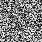

In [ ]:
from IPython.display import Image, display

loss, img = visualize_filter(0)
keras.preprocessing.image.save_img("0.png", img, scale=False)
display(Image("0.png"))

Processing filter 0
Processing filter 1
Processing filter 2
Processing filter 3
Processing filter 4
Processing filter 5
Processing filter 6
Processing filter 7
Processing filter 8
Processing filter 9
Processing filter 10
Processing filter 11
Processing filter 12
Processing filter 13
Processing filter 14
Processing filter 15
Processing filter 16
Processing filter 17
Processing filter 18
Processing filter 19
Processing filter 20
Processing filter 21
Processing filter 22
Processing filter 23
Processing filter 24
Processing filter 25
Processing filter 26
Processing filter 27
Processing filter 28
Processing filter 29
Processing filter 30
Processing filter 31
Processing filter 32
Processing filter 33
Processing filter 34
Processing filter 35
Processing filter 36
Processing filter 37
Processing filter 38
Processing filter 39
Processing filter 40
Processing filter 41
Processing filter 42
Processing filter 43
Processing filter 44
Processing filter 45
Processing filter 46
Processing filter 47
Pr

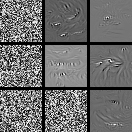

In [ ]:
# Compute image inputs that maximize per-filter activations
# for the first 64 filters of our target layer
all_imgs = []
for filter_index in range(64):
    print("Processing filter %d" % (filter_index,))
    loss, img = visualize_filter(filter_index)
    all_imgs.append(img)

# Build a black picture with enough space for
# our 8 x 8 filters of size 128 x 128, with a 5px margin in between
margin = 3
n = 3
cropped_width = 48 - 3 * 2
cropped_height = 48 - 3 * 2
width = n * cropped_width + (n - 1) * margin
height = n * cropped_height + (n - 1) * margin
stitched_filters = np.zeros((width, height, 1))

# Fill the picture with our saved filters
for i in range(n):
    for j in range(n):
        img = all_imgs[i * n + j]
        stitched_filters[
            (cropped_width + margin) * i : (cropped_width + margin) * i + cropped_width,
            (cropped_height + margin) * j : (cropped_height + margin) * j
            + cropped_height,
            :,
        ] = img
keras.preprocessing.image.save_img("stiched_filters.png", stitched_filters)

from IPython.display import Image, display

display(Image("stiched_filters.png"))

# 7 - Real life test

Step 1: Train a model above. Make sure it is saved to the variable `model`. Alternaitively, load one from memory using the code in section 7.1

Step 2: Capture a video where you are clearly visible and expressing emotions in mp4. To do this in GoogleColab, use the code in section 7.2, which will automatically capture a video from your webcam. Alternatively, upload and use a prerecorded video.

Step 3: Assuming steps 1 and 2 worked, you should be able to run 7.3, which will print the frames showing a bounding box on the face detected as well as text showing the predicted emotion. You will also need the linked .xml file for the facial recognition.



## 7.1 Save / Load model to/from disk

In [ ]:
model_json = model.to_json()
with open("model.json", "w") as json_file:
    json_file.write(model_json)
model.save_weights("model.h5")
print("Saved model to disk")

Saved model to disk


In [12]:
model = model_from_json(open(path+"model.json", "r").read())
model.load_weights(path+'model.h5')

## 7.2 Video Capture from Colab

The following code block (Section 7.2) lets you capture video from your webcam from Colab. Seeing as this (live recording from code) aspect is not a required part of the assignment, and a simple video could have been recorded and uploaded, we decided to have fun and implement it in Colab using the code found from the following source:

https://androidkt.com/how-to-capture-and-play-video-in-google-colab/

In [109]:
# Video capture in Colab code sourced from https://androidkt.com/how-to-capture-and-play-video-in-google-colab/

from IPython.display import display, Javascript,HTML
from google.colab.output import eval_js
from base64 import b64decode

def record_video(filename):
  js=Javascript("""
    async function recordVideo() {
      const options = { mimeType: "video/webm; codecs=vp9" };
      const div = document.createElement('div');
      const capture = document.createElement('button');
      const stopCapture = document.createElement("button");
      
      capture.textContent = "Start Recording";
      capture.style.background = "orange";
      capture.style.color = "white";

      stopCapture.textContent = "Stop Recording";
      stopCapture.style.background = "red";
      stopCapture.style.color = "white";
      div.appendChild(capture);

      const video = document.createElement('video');
      const recordingVid = document.createElement("video");
      video.style.display = 'block';

      const stream = await navigator.mediaDevices.getUserMedia({audio:true, video: true});
    
      let recorder = new MediaRecorder(stream, options);
      document.body.appendChild(div);
      div.appendChild(video);

      video.srcObject = stream;
      video.muted = true;

      await video.play();

      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      await new Promise((resolve) => {
        capture.onclick = resolve;
      });
      recorder.start();
      capture.replaceWith(stopCapture);

      await new Promise((resolve) => stopCapture.onclick = resolve);
      recorder.stop();
      let recData = await new Promise((resolve) => recorder.ondataavailable = resolve);
      let arrBuff = await recData.data.arrayBuffer();
      
      // stop the stream and remove the video element
      stream.getVideoTracks()[0].stop();
      div.remove();

      let binaryString = "";
      let bytes = new Uint8Array(arrBuff);
      bytes.forEach((byte) => {
        binaryString += String.fromCharCode(byte);
      })
    return btoa(binaryString);
    }
  """)
  try:
    display(js)
    data=eval_js('recordVideo({})')
    binary=b64decode(data)
    with open(filename,"wb") as video_file:
      video_file.write(binary)
    print(f"Finished recording video at:{filename}")
  except Exception as err:
    print(str(err))

In [122]:
video_path = "test.mp4"
record_video(video_path)

## 7.3 Set up facial recognition from Cascade Classifier 

In [118]:
# haarcascade .xml file is sourced from: https://github.com/opencv/opencv/tree/master/data/haarcascades

face_cascade = cv2.CascadeClassifier(path + 'haarcascade_frontalface_default.xml')

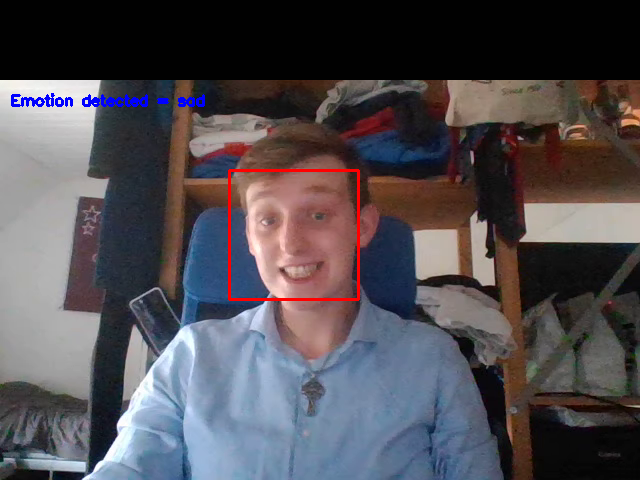

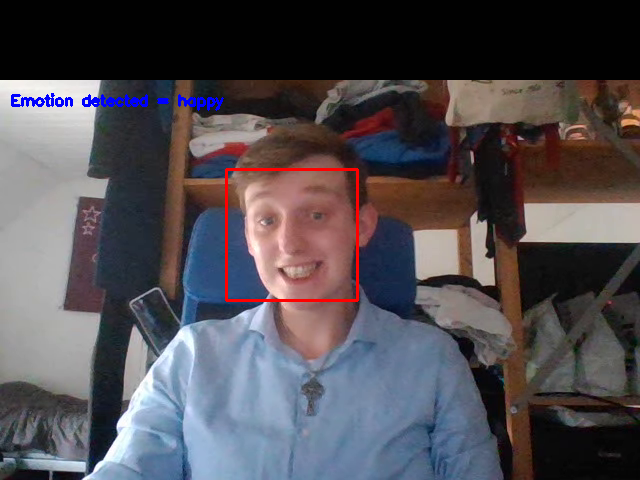

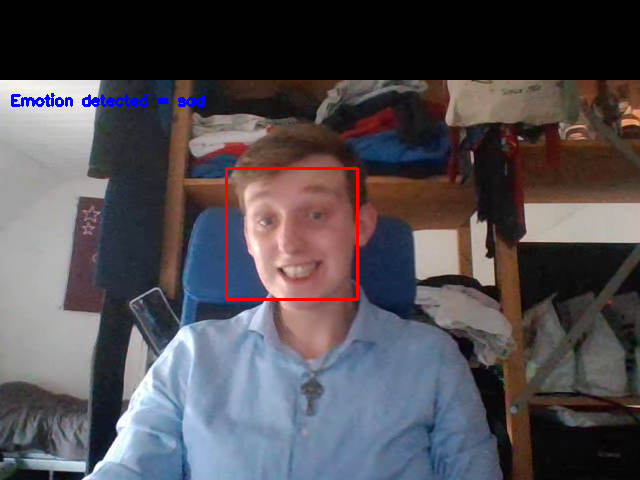

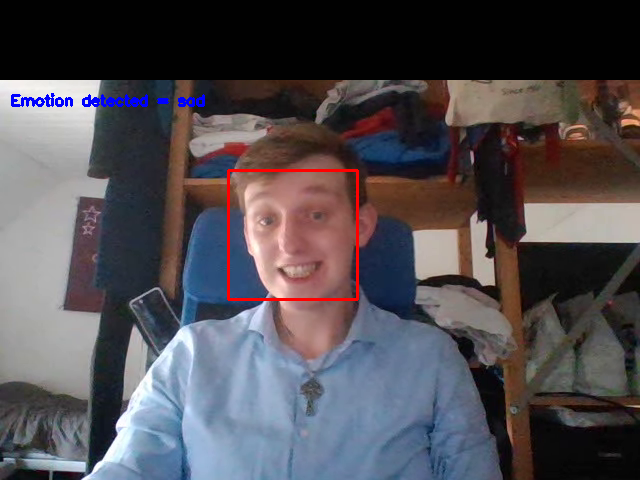

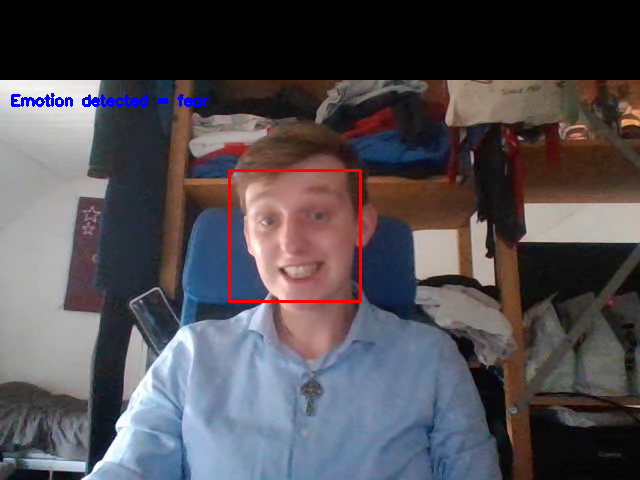

...

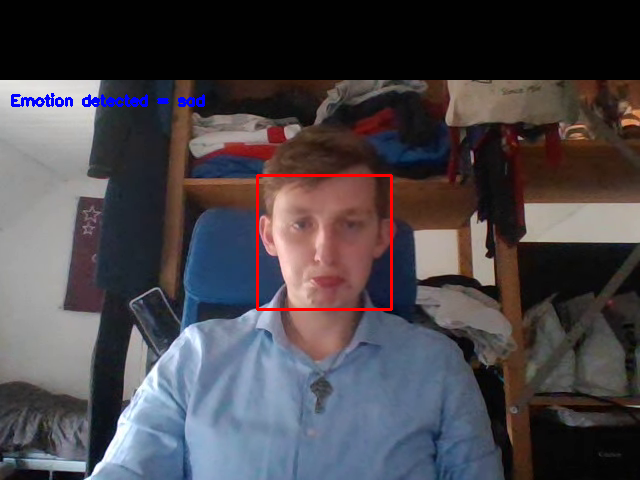

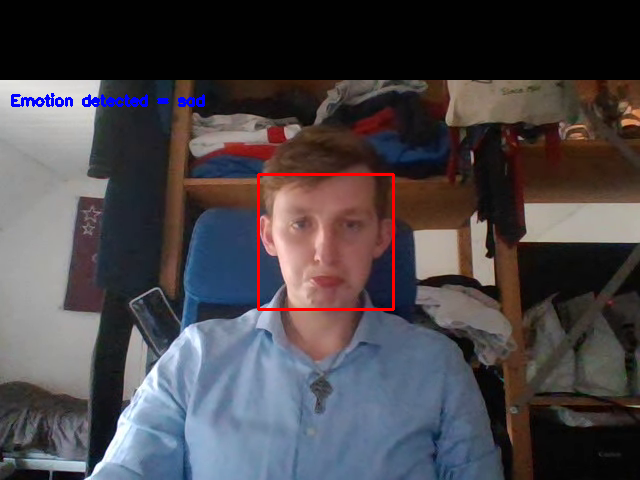

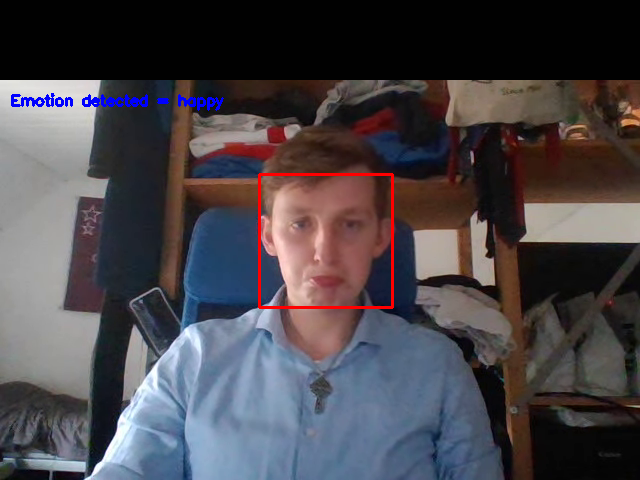

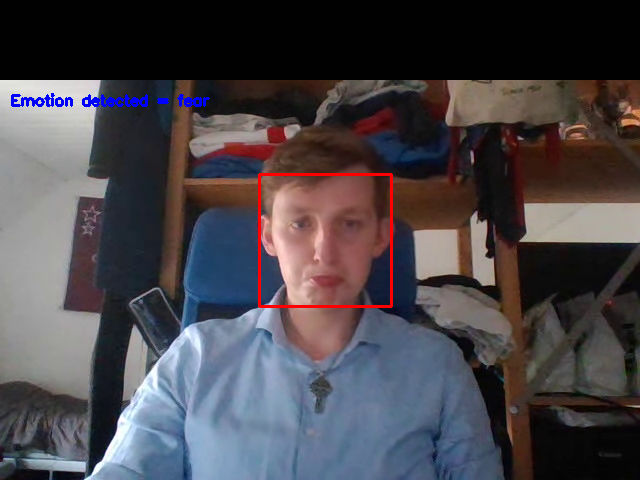

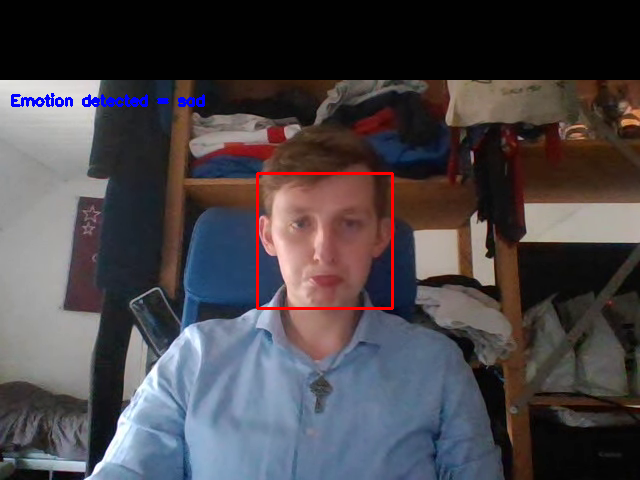

In [121]:
video = 'test.mp4'

cap = cv2.VideoCapture(video)

while cap.isOpened():
    _, image = cap.read()
    
    try:
      # Converting to grey scale
      grayscale = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

      # Allowing for multiple face detection
      faces = face_cascade.detectMultiScale(grayscale)

      # Set up label part of image
      font = cv2.FONT_HERSHEY_SIMPLEX

      for (x, y, w, h) in faces:
          # set up a box around the face
          cv2.rectangle(image, (x,y), (x+w, y+h), color = (0,0,255), thickness =  2)

          # isolate the face in the image
          face = grayscale[y:y+h, x:x+w]
          face = cv2.resize(face, (48,48))

          # turn list of pixel values into an array that can be used for prediction
          imageArray = np.expand_dims(face, axis = 0)

          # use the model to predict the emotion
          #  - returns probabilities for each emotion, find the highest probability
          predictions = model.predict(imageArray)
          max = np.argmax(predictions[0])

          emotions = ('angry', 'disgust', 'fear', 'happy', 'sad', 'surprise', 'neutral')
          emotion = emotions[max]    

          cv2.putText(image, f"Emotion detected = {emotion}", (10, 105), font, 0.5, (255,0,0), 2)

      image[0:int(height/6),0:int(width)] = res
      cv2_imshow(image)   # Version for Google colab. If not using Colab, use following line instead
      # cv2.imshow(image)   # Normal
    except:
      break